# Misspelled Word Analysis

In [5]:
#Importing the required packages
import pandas as pd
import swifter
import spacy
from autocorrect import Speller
nlp = spacy.load("en_core_web_md")
spell = Speller(lang='en')
from pyspark.sql import SparkSession, SQLContext
from pyspark.sql.functions import *
from pyspark.sql import types
from pyspark.sql.types import StringType
import time
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import string
import seaborn as sns
from bokeh.plotting import figure, ColumnDataSource, show, output_notebook; output_notebook()
from bokeh.models import HoverTool
from bokeh.palettes import brewer, Viridis256
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from wordcloud import WordCloud
from tabulate import tabulate
%matplotlib notebook
colors = sns.color_palette('Paired', 50).as_hex()

Loading BokehJS ...

In [8]:
#File names
#Please change the file names before running the file
wordsFile = 'part-00000-481943e0-3049-4c42-803a-93134747645e-c000.csv' #Folder: Misspelled_words.csv
clusterFile = 'March100k.bz2' #Folder: UserClustering100k
hashTagFile = 'HashtagData.json' #Folder: Hashtag

In [6]:
#Reading the pre-processed CSV file of all unique words
df = pd.read_csv(wordsFile)

In [7]:
#Calculating length of every word into a seperate column
df['len'] = df.word.apply(lambda x: len(str(x)))

In [8]:
#Filtering on the basis of word length. Discarding words with length less than 3 and more than 15
df = df[df.len > 3]
df = df[df.len < 15]

In [9]:
#Passing every word to spacy and checking if that word has a vector or not.
#If the has_vector is FALSE. Then, the word is misspelt
df['spacy'] = df.word.swifter.apply(lambda x: nlp(x))
df['hv'] = df.spacy.swifter.apply(lambda x: x[0].has_vector)

#Filterin on the basis of has_vector. Keeping only rows which gave FALSE
df = df[df.hv == False]

C:\Users\ngupt\.conda\envs\ds\lib\site-packages\tqdm\std.py:654: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [10]:
#Saving the output dataframe to a CSV file
df.to_csv('MisspelledWords.csv')

In [11]:
#This function takes a letter as an input and extracts all the words with starts from the letter into a new dataframe
def startswith(dataframe, letter):
    dataframe['startsWith'] = dataframe.word.swifter.apply(lambda x: x.startswith(letter.lower()))
    dataframe = dataframe[dataframe.startsWith == True]
    return dataframe

In [12]:
#Filtering out words
letter = 'n'
newdf = startswith(df, letter)

In [13]:
#Passing every misspelt word to 'Autocorrect' to generate the correct word
def autocorrect(item):
    return spell(item)
newdf['Corrected'] = newdf.word.swifter.apply(lambda x: autocorrect(x))

C:\Users\ngupt\.conda\envs\ds\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [14]:
#Keeping only the required columns from the dataframe
#Which are: word, count and Corrected
finaldf = newdf[['word','count', 'Corrected']]

In [15]:
#Changing column names of the final df
finaldf.columns = ['Word', 'ErrorCount', 'Corrected']

In [16]:
#Generating different metrics for the data.
#Generating ErrorCount which shows the number of times a word has been misspelt
f1=finaldf.groupby(['Corrected']).agg({'ErrorCount':"sum"})

#Generating a list of words which have the same autocorrected spelling
f2=finaldf.groupby(['Corrected']).agg(list)
f2 = f2.drop(columns=['ErrorCount'])

#Deriving a column 'Variations' which tell us the unique ways a word has been misspelt
f3=finaldf.groupby(['Corrected']).count()
f3 = f3.drop(columns=['Word'])
f3.columns = ['Variations']

In [17]:
#Merging all the columns sorting them by Variations and ErrorCount
result = pd.concat([f1, f2, f3], axis=1, sort=False)
result = result.sort_values(by=['Variations', 'ErrorCount'], ascending=False)

In [18]:
#Displaying the top 10 rows
result.head(10)

,ErrorCount,Word,Variations
Corrected,,,
name,503,"[namune, nxge, nayek, nijame, namnen, nameo, n...",126
not,420,"[notgc, ndgt, nctc, notp, nctx, nsgt, notg, ny...",117
night,468,"[ninight, nighttx, nihga, nighk, noight, nigha...",113
neck,680,"[neicy, nnkc, nycy, nechi, nmpk, nccd, neckp, ...",109
near,313,"[nojar, neagu, naafr, nnbr, nearmi, netac, npe...",104
never,281,"[nevez, nfver, neverif, neeerd, nenerv, nelere...",100
nail,546,"[nraila, nwpl, ndil, niakl, nadil, naail, nali...",94
news,379,"[nmcs, newmfs, newsoo, newwss, newqs, newsm, n...",91
now,288,"[nuhw, nmwj, ngfw, nowm, nfjw, nwowk, nowb, nh...",90


In [19]:
#Exporting this dataframe for final plotting in tableau
result.to_csv('Tableau.csv')

# User Clusterning 

## Reading the preprocessed user's data

### Initializing the spark session

In [39]:
spark = SparkSession.builder.getOrCreate()
sc = spark.sparkContext

In [40]:
# Reading top 100k users based of highest follower count
March100k = spark.read.json(clusterFile)

In [41]:
#Creating Pandas Dataframe from spark Dataframe
UsersDF = March100k.toPandas()

In [42]:
UsersDF.head(5)

,desc_string,user_description_org,user_followers_count,user_id_str,user_screen_name
0,let make world better join add justinbieber ne...,Let's make the world better. Join @bkstg and a...,77372859,27260086,justinbieber
1,get now,Get #ANTI now: http://smarturl.it/daANTI,56838482,79293791,rihanna
2,jazz art pop punk actress fashion magazine edi...,jazz art pop punk actress fashion magazine edi...,56575274,14230524,ladygaga
3,comedian talk show host ice road trucker tweet...,"Comedian, talk show host and ice road trucker....",55725104,15846407,TheEllenShow
4,discovering telling stories around world curat...,Discovering — and telling — stories from aroun...,40917588,180505807,instagram


In [43]:
#Taking some columns from UsersDF in list
user_description_list = UsersDF['desc_string'].tolist()
user_id_str_list=UsersDF['user_id_str'].tolist()
user_followers_count_list=UsersDF['user_followers_count'].tolist()
user_description_org_list = UsersDF['user_description_org'].tolist()
user_screen_name_list = UsersDF['user_screen_name'].tolist()

### Vectorization of user's description using Term Frequency–Inverse Document Frequency(TD-IDF) metric

In [44]:
#Tokenizing by spliting by space
def spliter(in_string):
    tokens = in_string.split()
    return tokens

#Creating Vectorizer model, with taking top 500 words from the description
vectorize = TfidfVectorizer(tokenizer=spliter,
                      max_features=500
                     )

desc_matrix = vectorize.fit_transform(user_description_list)

#Converting the spared matrix to dense matrix and creating pandas DF from it
desc_matrix_DF=pd.DataFrame(desc_matrix.todense())
desc_matrix_DF.columns=vectorize.get_feature_names()
desc_matrix_DF.head(5)

,account,across,activist,actor,actress,adult,advice,advocate,affiliated,africa,...,worldwide,write,writer,writing,year,years,york,young,youtube,youtuber
0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.38953,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


<IPython.core.display.Javascript object>


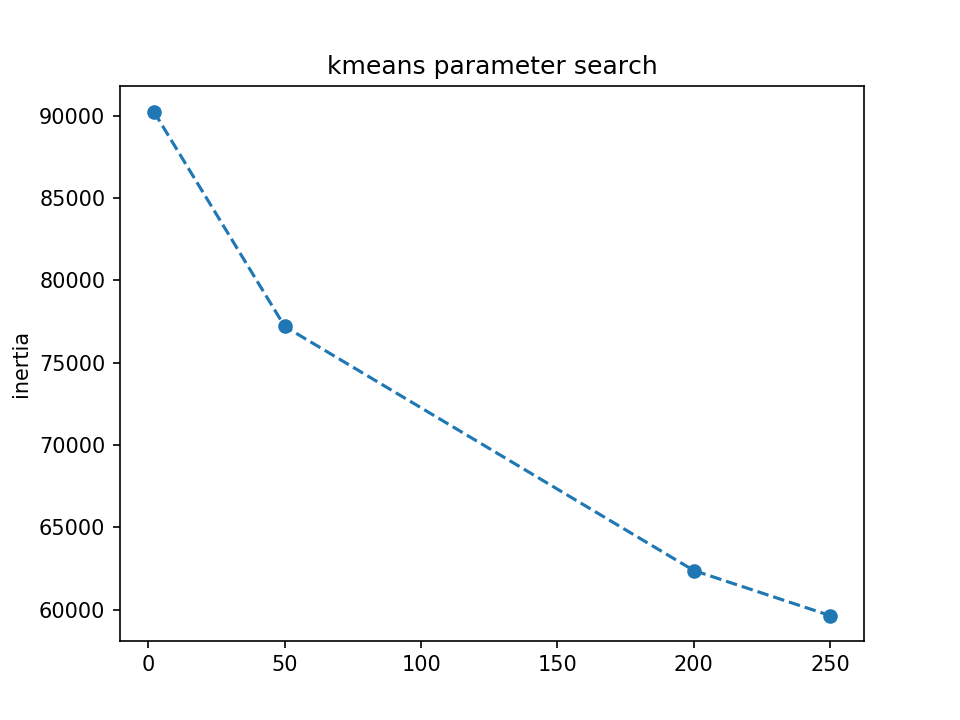

Text(0.5, 1.0, 'kmeans parameter search')

In [64]:
ks = [2, 50, 200, 250]
inertias = []
for k in ks:
    model = KMeans(n_clusters=k, n_jobs=-1, random_state=0)
    model.fit(desc_matrix_DF)
    labels = model.labels_
    inertias.append(model.inertia_)

fig, ax = plt.subplots(1, 1, sharex=True)

plt.subplot(111)
plt.plot(ks, inertias, 'o--')
plt.ylabel('inertia')
plt.title('kmeans parameter search')

### Using KMeans algorithm to cluster the user based on user's description

In [46]:
start = time.time()
#Passing the vectorized matrix created above to k-Means model for clustering
k=50
KMeans_model = KMeans(n_clusters=k, n_jobs=-1, random_state=0)
KMeans_model.fit(desc_matrix_DF)
end = time.time()
print("Process completed - %s seconds elapsed." % (end - start))

Process completed - 185.9664740562439 seconds elapsed.


### Function to get frequent words in cluster

In [47]:
def top_words_in_cluster(num_of_words=7,for_clusters=[],KMeans_model=KMeans_model,vectorize=vectorize):
    #getting the top 500 words which were used in vectorizer
    features = vectorize.get_feature_names()
    
    #If the cluster list is not given by user then giving output for all cluster
    if(len(for_clusters)==0):
        for_clusters = list(set(KMeans_model.labels_))
    
    #getting the centroid vectors (which will be having 500 dimentions) 
    #then taking the indices for sorted data, which will indicate which words are important for the cluster 
    centroids = KMeans_model.cluster_centers_.argsort()[:,::-1]
    
    #for getting the most important (frequent) words of the cluster 
    for this_label in for_clusters:
        print('Cluster '+str(this_label)+' -> ',end = '')
        for ind in centroids[this_label, :num_of_words]:
            print(features[ind]+' ', end='')
        print()

print('\nMost frequent words for few clusters: \n')
top_words_in_cluster(for_clusters=list(range(11, 17)))


Most frequent words for few clusters: 

Cluster 11 -> music producer com new news entertainment lover 
Cluster 12 -> hit music station follow com new show 
Cluster 13 -> love follow people live things always much 
Cluster 14 -> god love family first life people jesus 
Cluster 15 -> artist recording com producer songwriter music booking 
Cluster 16 -> contact com bookings booking business info inquiries 


### To vizualize the clustering, reducing the dimention

#### Reducing to 2 Dimention using PCA

In [48]:
# Reducing dimentions from 500 to 2 using PCA, for the 100k user description
pca_model2d = PCA(n_components=2)
pca_result2d = pca_model2d.fit_transform(desc_matrix_DF)
kmm = KMeans(n_clusters=k, n_jobs=-1, random_state=0)
kmm.fit(pca_result2d)
clustersLabels = kmm.predict(pca_result2d)
pca_result2d

array([[-0.03633315, -0.0601781 ],
       [-0.03219158, -0.04524041],
       [-0.03474854, -0.04623612],
       ...,
       [-0.02900439, -0.04717456],
       [-0.02437662, -0.0385951 ],
       [-0.02071956, -0.03515109]])

### Integrating the information - User's ID, description, cluster label, x and y co-ordinates, follower count etc

In [49]:
# gives unique color for each cluster
def color_map(x):
    return(colors[x])

#Combining the data, to get a consolidated dataframe
def get_summaryDF(user_id_str_list,user_description_org_list,KMeans_model_labels,pca_result,user_followers_count_list,colors):
    df = pd.DataFrame({'user_id_str': user_id_str_list,
                       'user_description_org': user_description_org_list,
                       'cluster_label': KMeans_model_labels,
                       'x_dim': pca_result[:,0],
                       'y_dim': pca_result[:,1],
                       'user_followers_count': user_followers_count_list,
                       'user_screen_name': user_screen_name_list,
                      })
    #Proving a colour to each cluster
    df['color'] = df['cluster_label'].apply(color_map)
    return df

KMeans_model_labels=KMeans_model.labels_
summaryDF=get_summaryDF(user_id_str_list,user_description_org_list,KMeans_model_labels,pca_result2d,user_followers_count_list,colors[:k])
summaryDF.head(5)

,user_id_str,user_description_org,cluster_label,x_dim,y_dim,user_followers_count,user_screen_name,color
0,27260086,Let's make the world better. Join @bkstg and a...,5,-0.036333,-0.060178,77372859,justinbieber,#e31a1c
1,79293791,Get #ANTI now: http://smarturl.it/daANTI,5,-0.032192,-0.045240,56838482,rihanna,#e31a1c
2,14230524,jazz art pop punk actress fashion magazine edi...,44,-0.034749,-0.046236,56575274,ladygaga,#cab2d6
3,15846407,"Comedian, talk show host and ice road trucker....",18,-0.025479,-0.051912,55725104,TheEllenShow,#fdbf6f
4,180505807,Discovering — and telling — stories from aroun...,19,-0.012277,-0.040966,40917588,instagram,#ff7f00


### Function to get User descriptions of a cluster

In [50]:
#Using the above summaryDF, provides user descriptions in a particular cluster
def get_desc_forCluster(clusterLabel=3,df=summaryDF):
    tempDF=df[df['cluster_label']==clusterLabel].sort_values(by=['user_followers_count'], ascending=False)
    print('\nUser\'s Descriptions for Cluster '+str(clusterLabel)+'\n\n')
    print(tempDF[['user_screen_name','user_description_org']])
    return tempDF[['user_screen_name','user_description_org']]

get_desc_forCluster(clusterLabel=8,df=summaryDF)
print()


User's Descriptions for Cluster 8


      user_screen_name                               user_description_org
5         ArianaGrande                                    dangerous woman
7                  JLo  #ShadesOfBlue Thursday's At 10pm On NBC, http:...
9         Harry_Styles         Raconteur.  http://smarturl.it/1DmitamDXiT
10      KevinHart4real  My name is Kevin Hart and I WORK HARD!!! That ...
11                espn  We talk about sports, sports, and well ... spo...
...                ...                                                ...
99993     searchmaster  Providing great content to help B2B Sales & Ma...
99994   SmileandMobile  Smile and Mobile is a tech blog that focuses o...
99995     davidstassen  The Mindy Project, Central Intelligence, email...
99998       weekndrwxo                               i teach you to dream
99999   violintutorpro                          Violin and Fiddle Teacher

[41698 rows x 2 columns]



### Example showing User description from our Dataframe and image of Twitter

### Using the PCA result ploting the users

In [52]:
SummaryDF=get_summaryDF(user_id_str_list,user_description_org_list,clustersLabels,pca_result2d,user_followers_count_list,colors[:k])
def user_plot(df, title='User Description Clustering by Kmeans'):
    plot_data = ColumnDataSource(df)
    user_plot_figure = figure(title=title, plot_width=900, plot_height=600, tools=('pan, box_zoom'))
    user_plot_figure.add_tools(
        HoverTool(tooltips = """<div"><p>Cluster label - @cluster_label</p>
                                <p>User ID - @user_id_str</p></div>""")
    )
    user_plot_figure.circle('x_dim', 'y_dim',
                     source=plot_data,
                     color='color',
                     fill_alpha=0.7,
                     size=6)
    return user_plot_figure

In [53]:
show(user_plot(SummaryDF))

### Follower count analysis based on user clusters

In [54]:
#Grouping by Cluster, taking the average of user_followers_count in every cluster
followerCountDF=summaryDF.groupby('cluster_label', as_index=False).agg({"user_id_str":"count","user_followers_count": "mean"}).\
                round(0).astype(int).sort_values(by=['user_followers_count'], ascending=False)

#Top five cluster with highest average followers count
top5clusters=followerCountDF['cluster_label'].head(5).tolist()
#renaming the columns
followerCountDF.columns=['cluster_label','users_count','Average_follower_count']
print('CLUSTERS WITH HIGHEST AVERAGE FOLLOWER COUNT: \n')
print(tabulate(followerCountDF.head(5), headers='keys', tablefmt='psql'))
print('\n\nTOP WORDS IN THE CLUSTERS ABOVE:\n')
top_words_in_cluster(num_of_words=15,for_clusters=top5clusters)
print('\n\nSOME OF THE USER DESCRIPTIONS OF THE TOP MOST CLUSTER: ')
DF_top_desc=get_desc_forCluster(clusterLabel=top5clusters[0],df=summaryDF)

CLUSTERS WITH HIGHEST AVERAGE FOLLOWER COUNT: 

+----+-----------------+---------------+--------------------------+
|    |   cluster_label |   users_count |   Average_follower_count |
|----+-----------------+---------------+--------------------------|
| 44 |              44 |           596 |                   293334 |
|  5 |               5 |          1748 |                   262653 |
| 24 |              24 |          2391 |                   217320 |
| 31 |              31 |          2193 |                   216107 |
| 39 |              39 |          3315 |                   202328 |
+----+-----------------+---------------+--------------------------+


TOP WORDS IN THE CLUSTERS ABOVE:

Cluster 44 -> actress model singer host com producer instagram songwriter writer lover wife bookings film author mother 
Cluster 5 -> now available new album itunes single com get download booking link free book music order 
Cluster 24 -> account official twitter follow news university welcome team foot

### Word Cloud of user description of users in most followed cluster

<IPython.core.display.Javascript object>


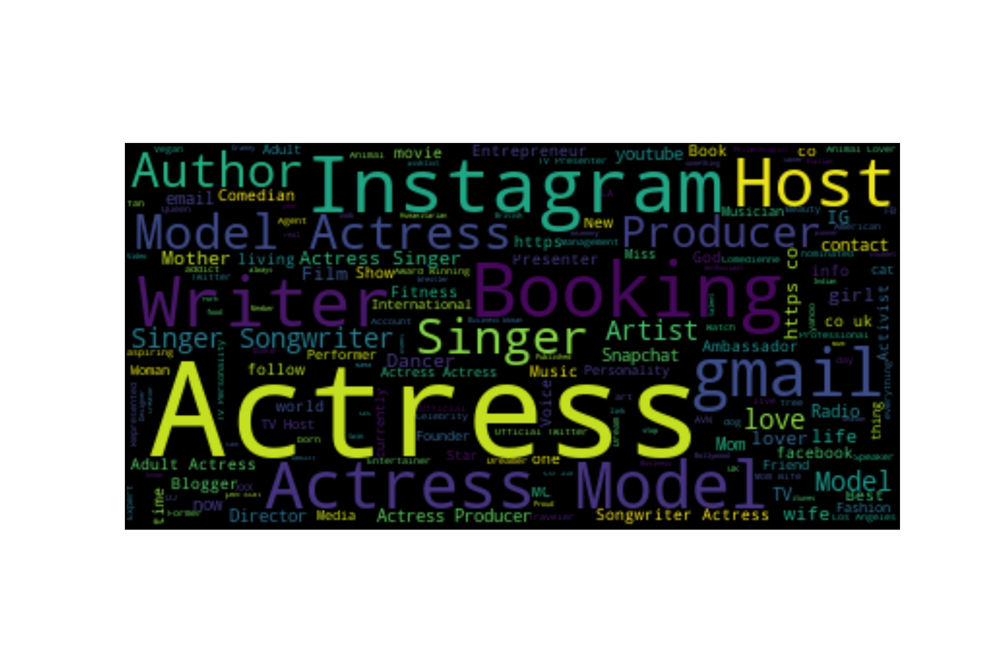

In [58]:
ser = pd.Series(DF_top_desc['user_description_org'])
textt=ser.str.cat(sep=' ')

wordcloud = WordCloud().generate(textt)
plt.figure(figsize=(15,10))
plt.savefig('topCluster.eps', format='eps')
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### ---User clustering and analysis end---

# Word Cloud of most frequent hashtags

In [59]:
hashtag_sDF = spark.read.json(hashTagFile)
hashtagDF=hashtag_sDF.toPandas()

In [60]:
hashtagDF

,count,hastag
0,608166,#iHeartAwards
1,511547,#BestFanArmy
2,214092,#5SOSFam
3,189586,#Harmonizers
4,100388,#Directioners
...,...,...
495,2231,#iTunes
496,2227,#webcam
497,2226,#Bitcoin
498,2225,#MSG2In500CrClub


<IPython.core.display.Javascript object>


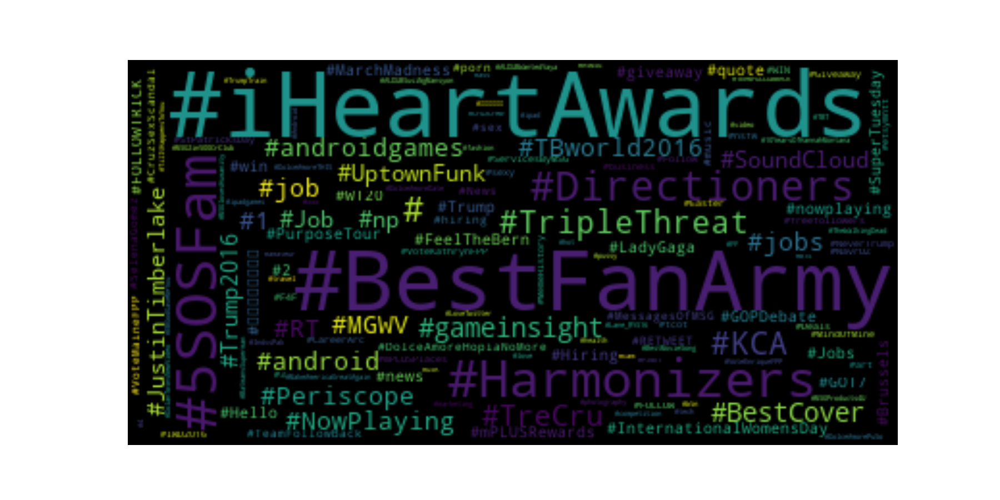

In [63]:
d = {}
for a, x in hashtagDF.values:
    d[x] = a

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud()
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure(figsize=(12,6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.savefig('hashtag.png')
plt.show()